In [1]:
library(ggplot2)
library(dplyr)
library(tidyr)
library(ggridges)


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union




In [2]:
motifs=read.table("chr1.GM12878.tf.deepSHAP.stats.tsv",header=TRUE,sep='\t')

In [3]:
head(motifs)

,Chrom,TFStart,TFEnd,TFName,VierstraScore,MeanDeepSHAP,MedianDeepSHAP,X90PercentileDeepSHAP,MaxDeepSHAP,MinDeepSHAP
,<fct>,<int>,<int>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,chr1,615,629,SIX4_MOUSE.H11MO.0.C,9.077500,-0.0004840838,-0.0005535734,-2.337963e-05,2.624081e-04,-0.0010038068
2,chr1,408,422,SIX4_MOUSE.H11MO.0.C,9.077500,-0.0002693953,-0.0002978671,1.833431e-04,2.647459e-04,-0.0007935142
3,chr1,214,228,SIX4_MOUSE.H11MO.0.C,9.077500,-0.0002189708,-0.0002596312,2.859102e-04,5.592579e-04,-0.0007826873
4,chr1,616,632,SIX2_MA1119.1,8.536966,-0.0005210989,-0.0005535734,-7.350306e-05,9.827381e-05,-0.0010038068
5,chr1,409,425,SIX2_MA1119.1,8.536966,-0.0002887581,-0.0002978671,1.804395e-04,2.647459e-04,-0.0008224434
6,chr1,215,231,SIX2_MA1119.1,8.536966,-0.0001744574,-0.0002544817,3.703734e-04,5.592579e-04,-0.0007826873


In [4]:
archetypes=read.table("chr1.GM12878.tf.deepSHAP.stats.archetypes.tsv",header=TRUE,sep='\t')

In [5]:
head(archetypes)

,Chrom,TFStart,TFEnd,TFName,VierstraScore,MeanDeepSHAP,MedianDeepSHAP,X90PercentileDeepSHAP,MaxDeepSHAP,MinDeepSHAP
,<fct>,<int>,<int>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,chr1,270,284,ZNF423,6.5876,3.937429e-04,2.412690e-04,0.001369621,0.001764386,-0.0004445344
2,chr1,270,286,NR/5,4.6386,3.388260e-04,1.595652e-04,0.001227341,0.001764386,-0.0004445344
3,chr1,276,292,MZF1,7.3395,2.559547e-04,1.203671e-04,0.001461079,0.001764386,-0.0012398119
4,chr1,280,294,NR/20,6.1913,1.539362e-04,-2.739369e-05,0.001509863,0.001764386,-0.0012398119
5,chr1,280,295,NR/17,7.4676,1.807345e-04,3.489147e-05,0.001485471,0.001764386,-0.0012398119
6,chr1,281,295,NR/20,9.0662,6.761653e-05,-2.739369e-05,0.001104155,0.001583040,-0.0012398119


In [6]:
options(repr.plot.width=8, repr.plot.height=200)

Picking joint bandwidth of 0.229

Picking joint bandwidth of 0.229



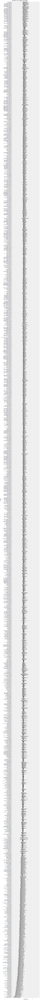

In [7]:
vierstra_tf_order=motifs %>% group_by(TFName) %>% mutate(OrderVierstra = mean(VierstraScore)) %>% arrange(OrderVierstra) %>% select (TFName) %>% unique()
motifs$TFName=factor(motifs$TFName,levels=vierstra_tf_order$TFName)

# Plot
ggplot(motifs, aes(x = `VierstraScore`, y = `TFName`)) +
  geom_density_ridges_gradient(scale = 3, rel_min_height = 0.01) +
  labs(title = 'GM12878, Chr1, Motifs in IDR peaks') +
    theme(
      legend.position="none",
      panel.spacing = unit(0.1, "lines"),
      strip.text.x = element_text(size = 8)
    )
ggsave("chr1.motif.vierstra_scores.pdf", width = 10, height = 200, units = "in",limitsize = FALSE)

Picking joint bandwidth of 0.000163

Picking joint bandwidth of 0.000163



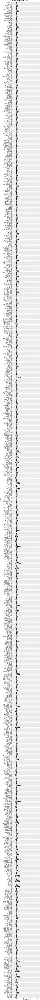

In [8]:
tf_order=motifs %>% group_by(TFName) %>% mutate(Order = mean(MeanDeepSHAP)) %>% arrange(MeanDeepSHAP) %>% select (TFName) %>% unique()
motifs$TFName=factor(motifs$TFName,levels=tf_order$TFName)

# Plot
ggplot(motifs, aes(x = `MeanDeepSHAP`, y = `TFName`)) +
  geom_density_ridges_gradient(scale = 3, rel_min_height = 0.01) +
  labs(title = 'GM12878, Chr1, Motifs in IDR peaks') +
    theme(
      legend.position="none",
      panel.spacing = unit(0.1, "lines"),
      strip.text.x = element_text(size = 8)
    )
ggsave("chr1.motif.meanDeepSHAP.pdf", width = 10, height = 200, units = "in",limitsize = FALSE)

Picking joint bandwidth of 0.000152

Picking joint bandwidth of 0.000152



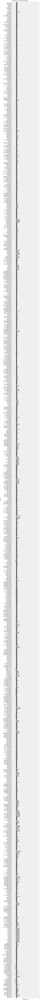

In [9]:
tf_order=motifs %>% group_by(TFName) %>% mutate(Order = mean(MedianDeepSHAP)) %>% arrange(MedianDeepSHAP) %>% select (TFName) %>% unique()
motifs$TFName=factor(motifs$TFName,levels=tf_order$TFName)

# Plot
ggplot(motifs, aes(x = `MedianDeepSHAP`, y = `TFName`)) +
  geom_density_ridges_gradient(scale = 3, rel_min_height = 0.01) +
  labs(title = 'GM12878, Chr1, Motifs in IDR peaks') +
    theme(
      legend.position="none",
      panel.spacing = unit(0.1, "lines"),
      strip.text.x = element_text(size = 8)
    )
ggsave("chr1.motif.MedianDeepSHAP.pdf", width = 10, height = 200, units = "in",limitsize = FALSE)

Picking joint bandwidth of 0.000331

Picking joint bandwidth of 0.000331



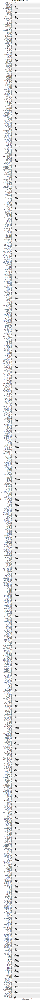

In [10]:
tf_order=motifs %>% group_by(TFName) %>% mutate(Order = mean(X90PercentileDeepSHAP)) %>% arrange(X90PercentileDeepSHAP) %>% select (TFName) %>% unique()
motifs$TFName=factor(motifs$TFName,levels=tf_order$TFName)

# Plot
ggplot(motifs, aes(x = `X90PercentileDeepSHAP`, y = `TFName`)) +
  geom_density_ridges_gradient(scale = 3, rel_min_height = 0.01) +
  labs(title = 'GM12878, Chr1, Motifs in IDR peaks') +
    theme(
      legend.position="none",
      panel.spacing = unit(0.1, "lines"),
      strip.text.x = element_text(size = 8)
    )
ggsave("chr1.motif.X90PercentileDeepSHAP.pdf", width = 10, height = 200, units = "in",limitsize = FALSE)

In [11]:
options(repr.plot.width=8, repr.plot.height=30)

Picking joint bandwidth of 0.211

Picking joint bandwidth of 0.211



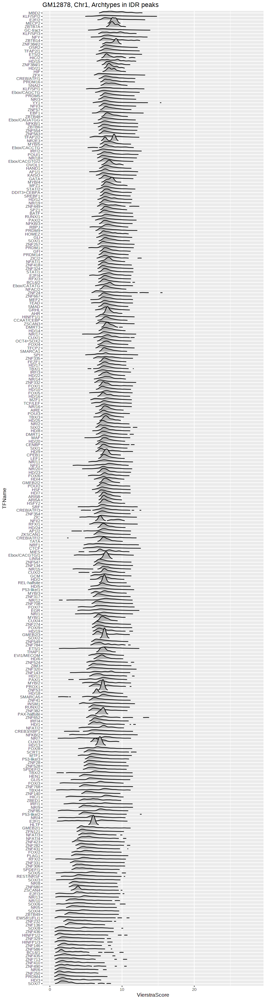

In [12]:
tf_order=archetypes %>% group_by(TFName) %>% mutate(Order = mean(VierstraScore)) %>% arrange(Order) %>% select (TFName) %>% unique()
archetypes$TFName=factor(archetypes$TFName,levels=tf_order$TFName)
ggplot(archetypes, aes(x = `VierstraScore`, y = `TFName`)) +
  geom_density_ridges_gradient(scale = 3, rel_min_height = 0.01) +
  labs(title = 'GM12878, Chr1, Archtypes in IDR peaks') +
    theme(
      legend.position="none",
      panel.spacing = unit(0.1, "lines"),
      strip.text.x = element_text(size = 8)
    )
ggsave("chr1.archetype.vierstra_scores.pdf", width = 10, height = 25, units = "in",limitsize = FALSE)

Picking joint bandwidth of 9.21e-05

Picking joint bandwidth of 9.21e-05



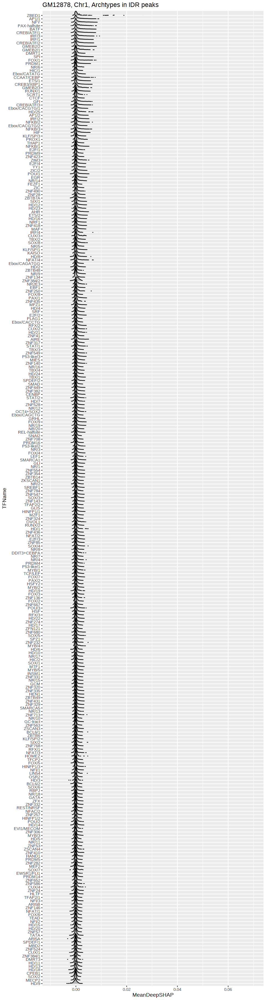

In [13]:
tf_order=archetypes %>% group_by(TFName) %>% mutate(Order = mean(MeanDeepSHAP)) %>% arrange(Order) %>% select (TFName) %>% unique()
archetypes$TFName=factor(archetypes$TFName,levels=tf_order$TFName)
ggplot(archetypes, aes(x = `MeanDeepSHAP`, y = `TFName`)) +
  geom_density_ridges_gradient(scale = 3, rel_min_height = 0.01) +
  labs(title = 'GM12878, Chr1, Archtypes in IDR peaks') +
    theme(
      legend.position="none",
      panel.spacing = unit(0.1, "lines"),
      strip.text.x = element_text(size = 8)
    )
ggsave("chr1.archetype.MeanDeepSHAP.pdf", width = 10, height = 25, units = "in",limitsize = FALSE)

Picking joint bandwidth of 0.000194

Picking joint bandwidth of 0.000194



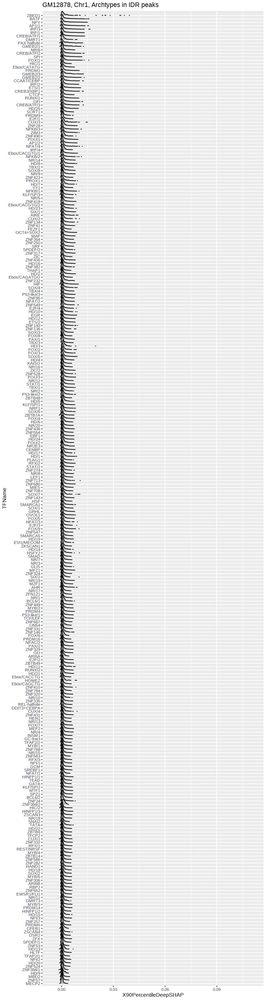

In [14]:
tf_order=archetypes %>% group_by(TFName) %>% mutate(Order = mean(X90PercentileDeepSHAP)) %>% arrange(Order) %>% select (TFName) %>% unique()
archetypes$TFName=factor(archetypes$TFName,levels=tf_order$TFName)
ggplot(archetypes, aes(x = `X90PercentileDeepSHAP`, y = `TFName`)) +
  geom_density_ridges_gradient(scale = 3, rel_min_height = 0.01) +
  labs(title = 'GM12878, Chr1, Archtypes in IDR peaks') +
    theme(
      legend.position="none",
      panel.spacing = unit(0.1, "lines"),
      strip.text.x = element_text(size = 8)
    )
ggsave("chr1.archetype.X90PercentileDeepSHAP.pdf", width = 10, height = 25, units = "in",limitsize = FALSE)

In [15]:
#get correlations 
print(cor(archetypes$VierstraScore,archetypes$MeanDeepSHAP,method = 'spearman'))
print(cor(archetypes$VierstraScore,archetypes$MeanDeepSHAP,method = 'pearson'))
#get correlations 
print(cor(motifs$VierstraScore,motifs$MeanDeepSHAP,method = 'spearman'))
print(cor(motifs$VierstraScore,motifs$MeanDeepSHAP,method = 'pearson'))

[1] 0.01825656
[1] 0.05146155
[1] 0.04654178
[1] 0.06740453


In [16]:
print(cor(archetypes$VierstraScore,archetypes$MedianDeepSHAP,method = 'spearman'))
print(cor(archetypes$VierstraScore,archetypes$MedianDeepSHAP,method = 'pearson'))
#get correlations 
print(cor(motifs$VierstraScore,motifs$MedianDeepSHAP,method = 'spearman'))
print(cor(motifs$VierstraScore,motifs$MedianDeepSHAP,method = 'pearson'))

[1] 0.01878605
[1] 0.05487724
[1] 0.04722054
[1] 0.06909153


In [17]:
print(cor(archetypes$VierstraScore,archetypes$X90PercentileDeepSHAP,method = 'spearman'))
print(cor(archetypes$VierstraScore,archetypes$X90PercentileDeepSHAP,method = 'pearson'))
print(cor(motifs$VierstraScore,motifs$X90PercentileDeepSHAP,method = 'spearman'))
print(cor(motifs$VierstraScore,motifs$X90PercentileDeepSHAP,method = 'pearson'))

[1] 0.002571506
[1] 0.03924513
[1] 0.02916529
[1] 0.05781326


In [18]:
print(cor(archetypes$VierstraScore,archetypes$MaxDeepSHAP,method = 'spearman'))
print(cor(archetypes$VierstraScore,archetypes$MaxDeepSHAP,method = 'pearson'))
print(cor(motifs$VierstraScore,motifs$MaxDeepSHAP,method = 'spearman'))
print(cor(motifs$VierstraScore,motifs$MaxDeepSHAP,method = 'pearson'))

[1] -6.446634e-05
[1] 0.0323631
[1] 0.02610192
[1] 0.05130878


In [19]:
print(cor(archetypes$VierstraScore,archetypes$MinDeepSHAP,method = 'spearman'))
print(cor(archetypes$VierstraScore,archetypes$MinDeepSHAP,method = 'pearson'))
print(cor(motifs$VierstraScore,motifs$MinDeepSHAP,method = 'spearman'))
print(cor(motifs$VierstraScore,motifs$MinDeepSHAP,method = 'pearson'))

[1] 0.02919731
[1] 0.02776617
[1] 0.03111664
[1] 0.02357617


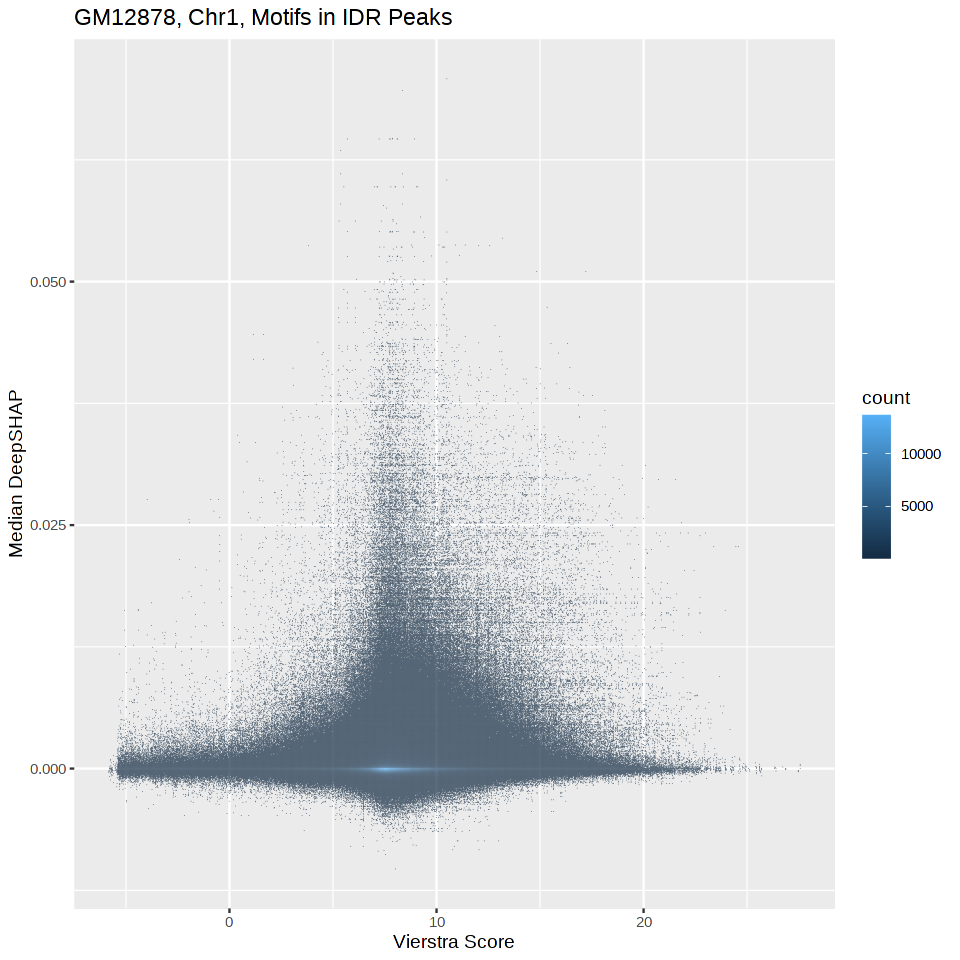

In [20]:
options(repr.plot.width=8, repr.plot.height=8)
ggplot(motifs,
      aes(x=VierstraScore,
         y=MedianDeepSHAP))+
 geom_hex(bins=1000) +
xlab("Vierstra Score")+
ylab("Median DeepSHAP")+
ggtitle("GM12878, Chr1, Motifs in IDR Peaks")

## fit 2 component gaussian mixture model to deepSHAP scores at the archetype level 

In [22]:
library(mixtools)

mixtools package, version 1.2.0, Released 2020-02-05
This package is based upon work supported by the National Science Foundation under Grant No. SES-0518772.




In [23]:
head(archetypes)

,Chrom,TFStart,TFEnd,TFName,VierstraScore,MeanDeepSHAP,MedianDeepSHAP,X90PercentileDeepSHAP,MaxDeepSHAP,MinDeepSHAP
,<fct>,<int>,<int>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,chr1,270,284,ZNF423,6.5876,3.937429e-04,2.412690e-04,0.001369621,0.001764386,-0.0004445344
2,chr1,270,286,NR/5,4.6386,3.388260e-04,1.595652e-04,0.001227341,0.001764386,-0.0004445344
3,chr1,276,292,MZF1,7.3395,2.559547e-04,1.203671e-04,0.001461079,0.001764386,-0.0012398119
4,chr1,280,294,NR/20,6.1913,1.539362e-04,-2.739369e-05,0.001509863,0.001764386,-0.0012398119
5,chr1,280,295,NR/17,7.4676,1.807345e-04,3.489147e-05,0.001485471,0.001764386,-0.0012398119
6,chr1,281,295,NR/20,9.0662,6.761653e-05,-2.739369e-05,0.001104155,0.001583040,-0.0012398119


In [26]:
archetype_names=unique(sort(archetypes$TFName))

In [27]:
archetype_names[0:10]

[1] MECP2    ZNF57    MBD2     HD/9     ZNF384/1 ZNF524   HD/20    NFI/2   
 [9] TFAP2/1  HLTF    
282 Levels: MECP2 ZNF57 MBD2 HD/9 ZNF384/1 ZNF524 HD/20 NFI/2 TFAP2/1 ... ZBED1

In [24]:
#for(archetype_name in archetype_names)
#{
archetype_name="CTCF"
df_subset=df$MeanDeepSHAP[archetypes$MeanDeepSHAP==archetype_name]

    mm_archetypes_mean=normalmixEM2comp(
        x=df_subset,
        lambda=0.80,
        mu=mean(df_subset),
    )
#}


ERROR: Error in normalmixEM2comp(archetypes$MeanDeepSHAP): argument "sigsqrd" is missing, with no default


In [34]:
archetype_name="CTCF"
df_subset=archetypes$MeanDeepSHAP[archetypes$TFName==archetype_name]


In [35]:
mean(df_subset)

[1] 0.0008621059

In [37]:
percentile(df_subset,0.85)

ERROR: Error in percentile(df_subset, 0.85): could not find function "percentile"


In [33]:
archetypes$MeanDeepSHAP[0:10]

[1]  3.937429e-04  3.388260e-04  2.559547e-04  1.539362e-04  1.807345e-04
 [6]  6.761653e-05 -1.139522e-04 -3.318710e-05 -6.073432e-05 -4.208972e-05